In [111]:
import h5py, os, pickle
from importlib import reload
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from matplotlib import cm
from imp import reload

from ecog.utils import bands
from cv_paper_plots.style import (subject_colors, letter_fontstyle,
                                  ticklabel_fontstyle, subject_labels)

import scipy as sp
from cv_paper_plots import xfreq_analysis as xfa
from cv_paper_plots import xfreq_classification as xfc
from cv_paper_plots import broadband
from cv_paper_plots.xfreq_analysis import good_examples_and_channels
from cv_paper_plots.broadband import (forward_bl, invert_bl, new_ch_idx, get_pcs, flip,
                                      baseline_mean_std, plot_PC1s, load_data, log_log_robust_regression)

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.linear_model import RANSACRegressor, TheilSenRegressor

from matplotlib import colors

from scipy.stats import ttest_ind, ranksums, mannwhitneyu

# Load data

In [4]:
folder = os.path.join(os.environ['HOME'],'Development/data/ecog/AA_ff/')
subjects = ['ec2', 'ec9', 'gp31', 'gp33']
files = ['EC2_blocks_1_8_9_15_76_89_105_CV_AA_ff_align_window_-0.5_to_0.79_none.h5',
         'EC9_blocks_15_39_46_49_53_60_63_CV_AA_ff_align_window_-0.5_to_0.79_none.h5',
         'GP31_blocks_1_2_4_6_9_21_63_65_67_69_71_78_82_83_CV_AA_ff_align_window_-0.5_to_0.79_none.h5',
         'GP33_blocks_1_5_30_CV_AA_ff_align_window_-0.5_to_0.79_none.h5']
cfs = bands.chang_lab['cfs']

In [5]:
subject_idx = 0
subject = subjects[subject_idx]

In [6]:
fname = os.path.join(folder, files[subject_idx])
X, baselines, good_examples, good_channels, tokens, block_labels, labels = load_data(fname)
print(subject)
X.min(), X.max()

2572 86
ec2


(9.888741e-09, 0.040291335)

In [5]:
with open('{}_bl_bb.pkl'.format(subject), 'rb') as f:
    bl_bb = pickle.load(f)

In [6]:
bl_mean_bb, bl_std_bb = baseline_mean_std(block_labels, good_channels, baselines, mb=bl_bb, cfs=cfs)

In [9]:
d = np.load('{}_bb.npz'.format(subject))
X_fits = d['X_bls']
X_medR2 = d['X_medR2']
kind = d['kind']

In [ ]:
X, _ = forward_bl(X, 'bl_zscore_bb', bl_mean_bb, bl_std_bb, block_labels, X_fits, cfs)

In [ ]:
plt.hist(X_medR2.ravel(), bins=100)
plt.yscale('log')
plt.ylabel('Counts')
plt.xlabel(r'R^2=1-($\Delta$pred^2/$\Delta$null^2)')
#plt.savefig('/home/jesse/Downloads/{}_medR2.pdf'.format(kind_names[kind]))

# XFreq Analysis

In [12]:
for ii, subject in enumerate(subjects):
    fname = os.path.join(folder, files[ii])
    X, baselines, good_examples, good_channels, tokens, block_labels, labels = load_data(fname)
    with open('{}_bl_bb.pkl'.format(subject), 'rb') as f:
        bl_bb = pickle.load(f)
    bl_mean_bb, bl_std_bb = baseline_mean_std(block_labels, good_channels, baselines, mb=bl_bb, cfs=cfs)
    d = np.load('{}_bb.npz'.format(subject))
    X_fits = d['X_bls']
    X_medR2 = d['X_medR2']
    kind = d['kind']
    X, _ = forward_bl(X, 'bl_zscore_bb', bl_mean_bb, bl_std_bb, block_labels, X_fits, cfs)
    f = {'X': X,
         'tokens': tokens,
         'y': labels}
    xfa.save_correlations(f, subject, bb2=True)
    xfa.save_hg_power(f, subject, bb2=True)

2572 86


In [25]:
reload(xfa)

<module 'cv_paper_plots.xfreq_analysis' from '/home/jesse/Development/cv_paper_plots/cv_paper_plots/xfreq_analysis.py'>

In [29]:
for ii, subject in enumerate(subjects):
    fname = os.path.join(folder, files[ii])
    X, baselines, good_examples, good_channels, tokens, block_labels, labels = load_data(fname)
    bl_mean, bl_std = baseline_mean_std(block_labels, good_channels, baselines)
    X, _ = forward_bl(X, 'bl_zscore', bl_mean, bl_std, block_labels)
    f = {'X': X,
         'tokens': tokens,
         'y': labels}
    print('here')
    break
    #xfa.save_correlations(f, subject, bb2=True)
    xfa.save_hg_power(f, subject, bb2=True)

2572 86
here


In [9]:
f = {'X': X,
     'tokens': tokens,
     'y': labels}

In [30]:
reload(xfa)
cv = 'gaa'
channels = [103, 106]
for ch in channels:
    xfa.save_power(f, new_ch_idx(ch, good_channels), cv, subject, bb2=True)

In [11]:
reload(xfa)
xfa.save_correlations(f, subject, bb2=True)

In [12]:
reload(xfa)
xfa.save_hg_power(f, subject, bb2=True)

-0.7244701 2.9057093
(40, 258)
-0.5865347 0.56471574
(40, 258)
-0.2557015446744596 0.3043626334466887
-0.3 0.4


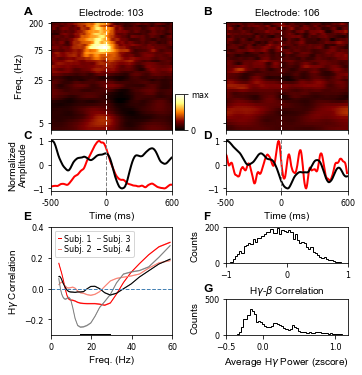

In [16]:
reload(xfa)
plt.close()
fig = plt.figure(figsize=(5, 5))

l_edge = .125
t_edge = .05
r_edge = .05
b_edge = .08

h_gap = .15

v1_gap = .025
v2_gap = .1

r1_height = .3
r3_height = .3
r2_height = 1. - t_edge - r1_height - v1_gap - v2_gap - r3_height - b_edge

width = (1. - l_edge - r_edge - h_gap) / 2.

c1_x = l_edge + width + h_gap

r1_y = v1_gap + r2_height + v2_gap + r3_height + b_edge
ax0 = fig.add_axes([l_edge, r1_y, width, r1_height])
ax1 = fig.add_axes([c1_x, r1_y, width, r1_height])
cax = fig.add_axes([c1_x - .95 * h_gap, 1. * r1_y, .025, .1])

r2_y =v2_gap + r3_height + b_edge
ax2 = fig.add_axes([l_edge, r2_y, width, r2_height])
ax3 = fig.add_axes([c1_x, r2_y, width, r2_height])

r3_y = b_edge
ax4 = fig.add_axes([l_edge, r3_y, width, r3_height])
r3_half_height = (r3_height - v2_gap) / 2
ax5 = fig.add_axes([c1_x, r3_y + r3_half_height + v2_gap, width, r3_half_height])
ax6 = fig.add_axes([c1_x, r3_y, width, r3_half_height])

subject = 'ec2'
cv = 'gaa'
ch = 103
im = xfa.plot_power(subject, new_ch_idx(ch, good_channels), cv, [ax0, ax2], vmin=-0.706203, vmax=2.9057093,
                    bb2=True, elabel=ch)

c = fig.colorbar(im, cax=cax)
c.set_ticks([-0.706203, 2.9057093])
c.set_ticklabels([0, 'max'])
c.ax.tick_params(labelsize=ticklabel_fontstyle['fontsize'])

ch = 106
xfa.plot_power(subject, new_ch_idx(ch, good_channels), cv, [ax1, ax3], vmin=-0.706203, vmax=2.9057093,
               bb2=True, elabel=ch)
ax0.set_xticklabels([])
ax1.set_xticklabels([])
ax1.set_yticklabels([])
ax1.set_ylabel('')
ax3.set_ylabel('')

xfa.plot_correlations(subjects, ax4, kind='freq', bb2=True)

xfa.plot_correlation_histogram(subject, ax5, bb2=True)

xfa.plot_power_histogram(subject, ax6, bb2=True)


x0 = .05
y0 = .97
x1 = .55
y1 = .625
y2 = .4
y3 = .2

fig.text(x0, y0, 'A', **letter_fontstyle)
fig.text(x1, y0, 'B', **letter_fontstyle)
fig.text(x0, y1, 'C', **letter_fontstyle)
fig.text(x1, y1, 'D', **letter_fontstyle)
fig.text(x0, y2, 'E', **letter_fontstyle)
fig.text(x1, y2, 'F', **letter_fontstyle)
fig.text(x1, y3, 'G', **letter_fontstyle)

plt.savefig('/home/jesse/Downloads/xfreq1_ff.eps', dpi=300)
plt.savefig('/home/jesse/Downloads/xfreq1_ff.png', dpi=300)

plt.show()

(4902,) (439, 57, 86)
ec2, 	m: 6.09e-01, 	b: -3.38e-01, 	R^2: 1.43e-01, 	p: 6.21e-86, 	stderr: 2.98e-02
(5643,) (439, 57, 99)
gp33, 	m: 5.42e-01, 	b: -7.85e-02, 	R^2: 3.50e-02, 	p: 1.98e-18, 	stderr: 6.13e-02
(4368,) (439, 56, 78)
ec9, 	m: -3.31e-01, 	b: -2.09e-02, 	R^2: 2.83e-02, 	p: 5.53e-21, 	stderr: 3.49e-02
ec9 0.17973134980447483 1.142163449595616
(4482,) (439, 54, 83)
gp31, 	m: -9.16e-01, 	b: -2.65e-01, 	R^2: 5.59e-02, 	p: 2.44e-32, 	stderr: 7.63e-02
gp31 0.16717264099741852 0.5532128128185418
432
810
506
520


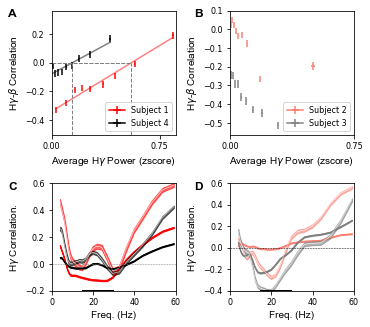

In [38]:
reload(xfa)
plt.close()
figsize=(5, 4.5)
fig = plt.figure(figsize=figsize)
x_over_y = figsize[0] / figsize[1]

l_edge = .13
t_edge = .02
r_edge = .03
b_edge = .115

v_gap = .15

h_gap = .15

width = (1. - l_edge - r_edge - h_gap) / 2.

r0_height = width * x_over_y
r1_height = (1. - t_edge - r0_height - v_gap - b_edge)

c1_x = l_edge + width + h_gap

r0_y = r1_height + v_gap + b_edge
ax0 = fig.add_axes([l_edge, r0_y, width, r0_height])
ax1 = fig.add_axes([c1_x, r0_y, width, r0_height])

r1_y = b_edge
ax2 = fig.add_axes([l_edge, r1_y, width, r1_height])
ax3 = fig.add_axes([c1_x, r1_y, width, r1_height])

#pcts = xfa.plot_power_correlations(['ec2', 'gp33'], ax0, bb2=True)
pcts = xfa.plot_power_correlations(['ec2', 'gp33'], ax0, bb2=True)

xfa.plot_power_correlations(['ec9', 'gp31'], ax1, cutoff_pct=np.mean(pcts), bb2=True)
#xfa.plot_power_correlations(['ec9', 'gp31'], ax1, cutoff_pct=90., bb2=True)
                                       
#xfa.plot_resolved_power_correlations(['ec2'], ax2, bb2=True)
xfa.plot_resolved_power_correlations(['ec2', 'gp33'], ax2, bb2=True)
xfa.plot_resolved_power_correlations(['ec9', 'gp31'], ax3, hline_c='black', bb2=True)

x0 = .01
y0 = r0_y + r0_height - .02
x1 = .525
y1 = r1_y + r1_height - .02

fig.text(x0, y0, 'A', **letter_fontstyle)
fig.text(x1, y0, 'B', **letter_fontstyle)
fig.text(x0, y1, 'C', **letter_fontstyle)
fig.text(x1, y1, 'D', **letter_fontstyle)

plt.savefig('/home/jesse/Downloads/xfreq2_ff.eps', dpi=300)
plt.savefig('/home/jesse/Downloads/xfreq2_ff.png', dpi=300)

plt.show()

In [39]:
pcts

[91.18727050183598, 85.64593301435407]

In [32]:
which = 'ds'
with open(os.path.join(os.environ['HOME'], 'plots_ff/xfreq/data/multiband_results_{}.pkl'.format(which)), 'rb') as f:
    data = pickle.load(f, encoding='latin1')
single, multi, single_a, multi_a = data

In [33]:
bands = [r'$\theta$', r'$\alpha$', r'$\beta$', r'$\gamma$']
band_abbreviations = ['t', 'a', 'b', 'g']
d = np.load(os.path.join(os.environ['HOME'], 'plots/ds/data/dataset_chance.npz'))
chance = d['chance_data'][0, :, -1].mean(axis=-1)
training_size = d['training_size']
subjects = ['ec2', 'ec9', 'gp31', 'gp33']

t, pA: 4.72e-03
t, pB: 2.36e+00

a, pA: 1.74e-04
a, pB: 3.47e-04

b, pA: 1.36e-05
b, pB: 1.82e-02

g, pA: 2.81e-07
g, pB: 4.38e-04



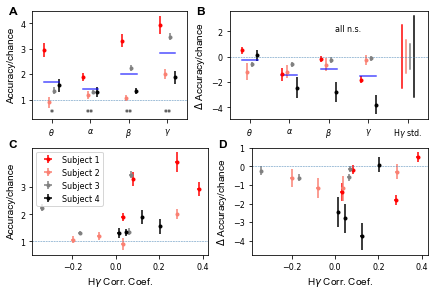

In [37]:
plt.close()
reload(xfc)
f= plt.figure(figsize=(6, 4))

l_edge = .075
r_edge = .01
t_edge = .03
b_edge = .125

h_gap = .1
v_gap = .1

height = (1. - t_edge - b_edge - v_gap) / 2.
width = (1. - l_edge - r_edge - h_gap) / 2.

c0_x = l_edge
r0_y = b_edge + height + v_gap
del_x = .05
c1_x = l_edge + (width - del_x) + h_gap
ax0 = f.add_axes([c0_x, r0_y, width - del_x, height])
ax1 = f.add_axes([c1_x, r0_y, width + del_x, height])

c0_x = l_edge
r0_y = b_edge
c1_x = l_edge + width + h_gap
ax2 = f.add_axes([c0_x, r0_y, width, height])
ax3 = f.add_axes([c1_x, r0_y, width, height])

xfc.plot_xfreq_classification(subjects, band_abbreviations, bands,
                                               single_a, multi_a, chance, [ax0, ax1])

xfc.plot_correlation_vs_accuracy(subjects, band_abbreviations, bands,
                                                  single_a, multi_a, chance, [ax2, ax3], bb2=True)

x0 = .02
y0 = .96
x1 = .455
y1 = .5
x2 = .505

f.text(x0, y0, 'A', **letter_fontstyle)
f.text(x1, y0, 'B', **letter_fontstyle)
f.text(x0, y1, 'C', **letter_fontstyle)
f.text(x2, y1, 'D', **letter_fontstyle)

plt.savefig(os.path.join(os.environ['HOME'], 'Downloads/multiband_{}.png'.format(which)), dpi=300)
plt.savefig(os.path.join(os.environ['HOME'], 'Downloads/multiband_{}.eps'.format(which)), dpi=300)
plt.show()

In [92]:
(single_a['hg'][:, 2] / chance).mean(axis=-1)

array([0., 0., 0., 0.])

In [98]:
cv_channels = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                      '{}_hg_power_cutoff.npz'.format(subject)))['cv_channels']
d = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                        '{}_correlations.npz'.format(subject)))['xcorr_time']
d = d[d.shape[0] // 2]
d_bb2 = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                        '{}_correlations_bb2.npz'.format(subject)))['xcorr_time']
d_bb2 = d_bb2[d_bb2.shape[0] // 2]
power_data = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                                  '{}_hg_power.npz'.format(subject)))['power_data']
power_data = power_data[..., xfa.hg_power_s].mean(axis=-1)

In [99]:
print(cv_channels.sum())

365


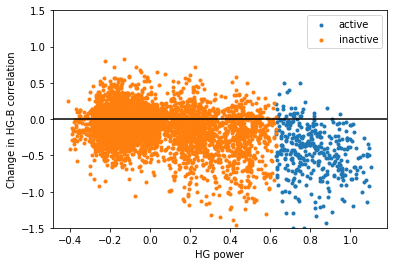

In [85]:
xh = power_data.ravel()[np.where(cv_channels.ravel())[0]]
yh = (d_bb2 - d).ravel()[np.where(cv_channels.ravel())[0]]
xl = power_data.ravel()[np.where(~cv_channels.ravel())[0]]
yl = (d_bb2 - d).ravel()[np.where(~cv_channels.ravel())[0]]
plt.scatter(xh, yh, marker='.', label='active')
plt.scatter(xl, yl, marker='.', label='inactive')
plt.xlabel('HG power')
plt.ylabel('Change in HG-B correlation')
plt.ylim(-abs(y).max(), abs(y).max())
plt.axhline(0, 0, 1, c='k')
plt.legend(loc='best')
plt.savefig('/home/jesse/Downloads/change_power.png', dpi=300)

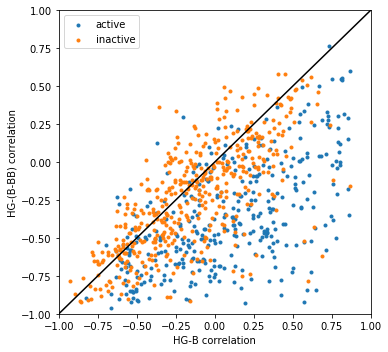

In [90]:
plt.figure(figsize=(5.5, 5))
xh = d.ravel()[np.where(cv_channels.ravel())[0]]
yh = d_bb2.ravel()[np.where(cv_channels.ravel())[0]]
xl = d.ravel()[np.where(~cv_channels.ravel())[0]]
yl = d_bb2.ravel()[np.where(~cv_channels.ravel())[0]]
plt.scatter(xh, yh, marker='.', label='active')
plt.scatter(xl[::10], yl[::10], marker='.', label='inactive')
plt.xlim(-1, 1)
plt.ylim(-1, 1)
plt.xlabel('HG-B correlation')
plt.ylabel('HG-(B-BB) correlation')
plt.plot([-1, 1], [-1, 1], c='k')
plt.legend(loc='best')
plt.tight_layout()
plt.savefig('/home/jesse/Downloads/corr_before_after.png', dpi=300)

In [59]:
df = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                        '{}_correlations.npz'.format(subject)))['xcorr_freq']
df_bb2 = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                        '{}_correlations_bb2.npz'.format(subject)))['xcorr_freq']

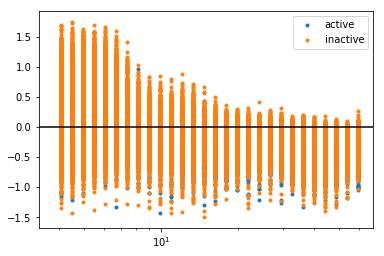

In [75]:
idxs = np.where(cfs < 60)[0]
x = cfs[idxs]
yh = (df_bb2 - df).reshape(40, -1)[:, np.where(cv_channels.ravel())[0]][idxs]
yl = (df_bb2 - df).reshape(40, -1)[:, np.where(~cv_channels.ravel())[0]][idxs]
plt.scatter(np.tile(x[:, np.newaxis], (1, yh.shape[1])).ravel(), yh.ravel(), marker='.', label='active')
plt.scatter(np.tile(x[:, np.newaxis], (1, yl.shape[1])).ravel(), yl.ravel(), marker='.', label='inactive')
plt.axhline(0, 0, 1, c='k')
plt.xscale('log')
plt.legend(loc='best')

In [80]:
50-(68.27-50)/2

40.865

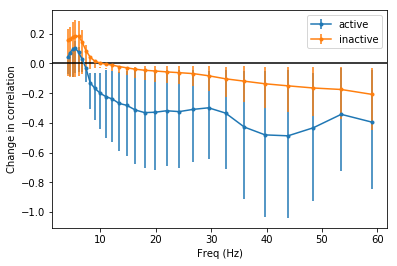

In [91]:
idxs = np.where(cfs < 60)[0]
x = cfs[idxs]
yh = (df_bb2 - df).reshape(40, -1)[:, np.where(cv_channels.ravel())[0]][idxs]
yl = (df_bb2 - df).reshape(40, -1)[:, np.where(~cv_channels.ravel())[0]][idxs]
plt.errorbar(x, np.median(yh, axis=1), yerr=np.percentile(yh, [59.135, 40.865], axis=1), marker='.', label='active')
plt.errorbar(x, np.median(yl, axis=1), yerr=np.percentile(yl, [59.135, 40.865], axis=1), marker='.', label='inactive')
plt.axhline(0, 0, 1, c='k')
plt.xlabel('Freq (Hz)')
plt.ylabel('Change in correlation')
plt.legend(loc='best')
plt.savefig('/home/jesse/Downloads/change_by_freq.png', dpi=300)

In [63]:
yh.shape

(40, 365)

# Baseline 1/f fits

In [3]:
reload(broadband)
for ii, subject in enumerate(subjects):
    print(subject)
    fname = os.path.join(folder, files[ii])
    X, baselines, good_examples, good_channels, tokens, block_labels, labels = load_data(fname)
    bl_bb = {}
    for b in sorted(set(block_labels)):
        print(b)
        bl_a = np.full((40, len(good_channels), baselines[(b, 0)].shape[1]), np.nan)
        for ii in range(40):
            bl_a[ii] = baselines[(b, ii)][good_channels]
        bl_bb[str(b)] = broadband.calc_bb_fit(cfs, bl_a, kind=2)
    with open('{}_bl_bb.pkl'.format(subject), 'wb') as f:
        pickle.dump(bl_bb, f)

ec2
2572 86
1
8
9
15
76
89
105
ec9
1570 78
15
39
46
49
53
60
63
gp31
5209 83
1
2
4
6
9
21
63
65
67
69
71
78
82
83
gp33
1422 99
1
5
30


Text(0.5,0,'R^2=1-($\\Delta$pred^2/$\\Delta$null^2)')

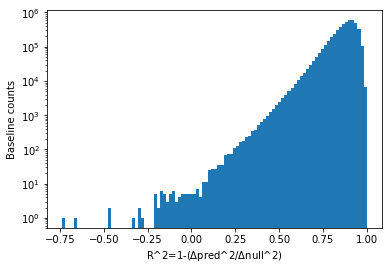

In [35]:
R2s = []
for k, v in bl_bb.items():
    R2s.append(v[1].ravel())
R2s = np.concatenate(R2s)
plt.hist(R2s.ravel(), bins=100)
plt.yscale('log')
plt.ylabel('Baseline counts')
plt.xlabel(r'R^2=1-($\Delta$pred^2/$\Delta$null^2)')

# BB Errors

In [6]:
X = np.log(X)
X -= np.log(broadband.calc_bb_estimate(cfs, X_fits[..., 0], X_fits[..., 1]))

In [7]:
def plot_errors(x, errors, ax, xlabel, title=None):
    ax.plot(x, errors)
    if xlabel is not None:
        ax.set_xlabel(xlabel)
    ax.set_ylabel('Median Error')
    if title is not None:
        ax.set_title(title)
    ax.axhline(0, 0, 1, c='k')
    m = abs(errors).max() * 1.1
    ax.set_ylim(-m, m)

In [8]:
meds = np.zeros(40)
for ii in range(40):
    meds[ii] = np.median(X[ii])

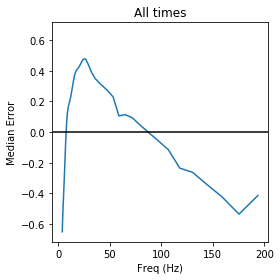

In [9]:
f, ax = plt.subplots(1, figsize=(4, 4))
plot_errors(cfs, meds, ax, 'Freq (Hz)', title='All times')
f.tight_layout()
plt.savefig('/home/jesse/Downloads/freq_avg_all_time.pdf')

In [10]:
t = np.linspace(-500, 790, X.shape[-1])
meds_t = np.zeros(t.size)
for ii in range(t.size):
    meds_t[ii] = np.median(X[..., ii])

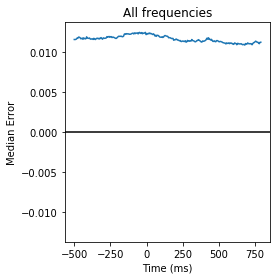

In [11]:
f, ax = plt.subplots(1, figsize=(4, 4))
plot_errors(t, meds_t, ax, 'Time (ms)', title='All frequencies')
f.tight_layout()
plt.savefig('/home/jesse/Downloads/time_avg_all_freq.pdf')

In [12]:
t = np.linspace(-500, 790, X.shape[-1])
meds_b = np.zeros((40, t.size))
for ii in range(40):
    for jj in range(t.size):
        meds_b[ii, jj] = np.median(X[ii, ..., jj])

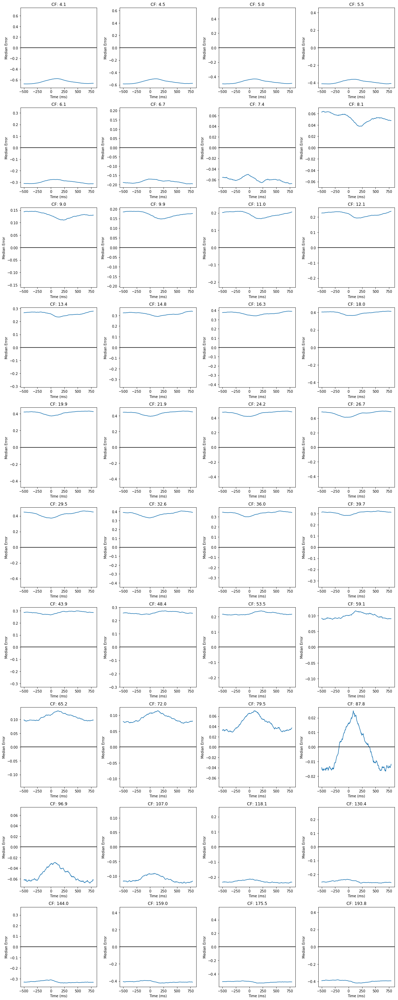

In [85]:
f, axes = plt.subplots(10, 4, figsize=(16, 40))
for ii in range(40):
    ax = axes.ravel()[ii]
    plot_errors(t, meds_b[ii], ax, 'Time (ms)', title='CF: {}'.format(np.around(cfs[ii], 1)))
f.tight_layout()
plt.savefig('/home/jesse/Downloads/time_freq.pdf')

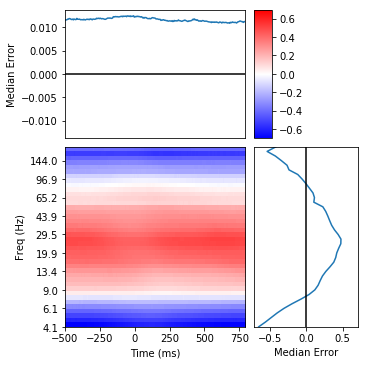

In [13]:
def plot_errors(x, errors, ax, xlabel, title=None):
    ax.plot(x, errors)
    if xlabel is not None:
        ax.set_xlabel(xlabel)
    ax.set_ylabel('Median Error')
    if title is not None:
        ax.set_title(title)
    ax.axhline(0, 0, 1, c='k')
    m = abs(errors).max() * 1.1
    ax.set_ylim(-m, m)
    ax.set_xlim(x[0], x[-1])

def plot_errors2(x, errors, ax, ylabel, title=None):
    x = np.arange(x.size)
    ax.plot(errors, x)
    if ylabel is not None:
        ax.set_ylabel(ylabel)
    ax.set_xlabel('Median Error')
    if title is not None:
        ax.set_title(title)
    ax.axvline(0, 0, 1, c='k')
    m = abs(errors).max() * 1.1
    ax.set_xlim(-m, m)
    ax.set_ylim(x[0], x[-1])

f = plt.figure(figsize=(5, 5))
le = .175
re = .01
te = .02
be = .1
s_w = .5
s_h = .5
v_g = .025
h_g = .025
cw = .05

ax0 = f.add_axes([le, be, s_w, s_h])

m = abs(meds_b).max()
im = ax0.imshow(meds_b[::-1], extent=[-500, 790, cfs[0], cfs[-1]], cmap='bwr', vmin=-m, vmax=m, aspect='auto')
ax0.set_yticks(np.linspace(cfs[0], cfs[-1], 40)[::4])
ax0.set_yticklabels(np.around(cfs, 1)[::4])
ax0.set_xlabel('Time (ms)')
ax0.set_ylabel('Freq (Hz)')

x1 = le + s_w + h_g
y1 = be + s_h + v_g
ax1 = f.add_axes([le, y1, s_w, 1 - (y1 + te) ])
ax2 = f.add_axes([x1, be, 1 - (x1 + re), s_h ])
cax = f.add_axes([le + s_w + h_g, y1, cw, 1 - (y1 + te)])

f.colorbar(im, cax)
plot_errors(t, meds_t, ax1, None)
plot_errors2(cfs, meds, ax2, None)
ax1.set_xticks([])
ax2.set_yticks([])


plt.savefig('/home/jesse/Downloads/time_freq_heat.pdf')

In [46]:
t = np.linspace(-500, 790, X.shape[-1])
meds_bhg = np.zeros((2, t.size))
beta, hg = xfa.extract_b_hg(X)
for ii in range(t.size):
    meds_bhg[0, ii] = np.median(beta[..., ii])
    meds_bhg[1, ii] = np.median(hg[..., ii])

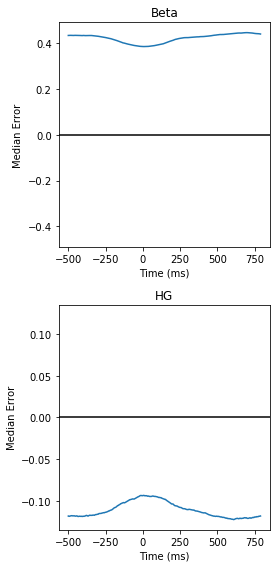

In [86]:
f, (ax0, ax1) = plt.subplots(2, figsize=(4, 8))
plot_errors(t, meds_bhg[0], ax0, 'Time (ms)', title='Beta')

plot_errors(t, meds_bhg[1], ax1, 'Time (ms)', title='HG')
f.tight_layout()
plt.savefig('/home/jesse/Downloads/beta_hg.pdf')

# BB checks

In [7]:
reload(xfa)
#ac_m = broadband.auto_corr(X_fits[..., 0])
#ac_b = broadband.auto_corr(X_fits[..., 1])
beta, hg = xfa.extract_b_hg(X)
#ac_hg = xfa.auto_corr(hg)
#ac_beta = broadband.auto_corr(beta)

In [ ]:
f, axes = plt.subplots(2, 2, figsize=(6, 6))
x = 5 * (np.arange(ac_m.size) - ac_m.size //2)
axes[0, 0].plot(x, ac_m)
axes[0, 0].set_title('Slope')
axes[0, 1].plot(x, ac_b)
axes[0, 1].set_title('Intercept')
axes[1, 0].plot(x, ac_hg)
axes[1, 0].set_title('High gamma')
axes[1, 1].plot(x, ac_beta)
axes[1, 1].set_title('Beta')

for ax in axes.ravel():
    ax.set_ylabel('Autocorrelation')
    ax.set_xlabel('Time (ms)')
f.tight_layout()
plt.savefig('/home/jesse/Downloads/{}_autocorr.pdf'.format(kind_names[kind]))

In [30]:
f, axes = plt.subplots(85, 2, figsize=(2*8, 85*8))
x = np.linspace(-500, 790, 258)
for ii in range(85):
    axr = axes[ii]
    for jj in np.arange(57):
        ax = axr[ 0]
        ax.plot(x, bls[jj, ii, :, 0])
        ax.set_ylabel('Slope')
        ax = axr[1]
        ax.plot(x, bls[jj, ii, :, 1])
        ax.set_ylabel('Intercept')
for ax in axes.ravel():
    ax.set_ylim(None, 0)
f.tight_layout()
plt.savefig('/home/jesse/Downloads/{}_slope_intercept.pdf'.format(kind_names[kind]))

In [43]:
ccs_hg_m = broadband.correlate_ts(bls[..., 0], hg.mean(axis=0))
ccs_hg_b = broadband.correlate_ts(bls[..., 1], hg.mean(axis=0))
ccs_beta_m = broadband.correlate_ts(bls[..., 0], beta.mean(axis=0))
ccs_beta_b = broadband.correlate_ts(bls[..., 1], beta.mean(axis=0))
ccs_m_b = broadband.correlate_ts(bls[..., 0], bls[..., 1])

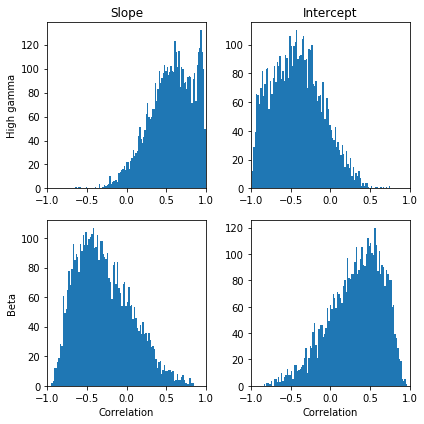

In [59]:
reload(broadband)
f, axes = plt.subplots(2, 2, figsize=(6, 6))
axes[0, 0].hist(ccs_hg_m.ravel(), bins=100)
axes[0, 1].hist(ccs_hg_b.ravel(), bins=100)
axes[1, 0].hist(ccs_beta_m.ravel(), bins=100)
axes[1, 1].hist(ccs_beta_b.ravel(), bins=100)
axes[0, 0].set_title('Slope')
axes[0, 1].set_title('Intercept')
axes[0, 0].set_ylabel('High gamma')
axes[1, 0].set_ylabel('Beta')
for ax in axes.ravel():
    ax.set_xlim(-1, 1)
for ax in axes[1]:
    ax.set_xlabel('Correlation')
f.tight_layout()
plt.savefig('/home/jesse/Downloads/correlations.pdf')

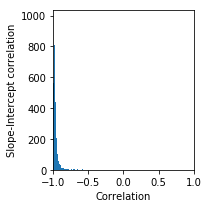

In [60]:
f, ax = plt.subplots(1, 1, figsize=(3, 3))
ax.hist(ccs_m_b.ravel(), bins=100)
ax.set_xlabel('Correlation')
ax.set_ylabel('Slope-Intercept correlation')
ax.set_xlim(-1, 1)
f.tight_layout()
plt.savefig('/home/jesse/Downloads/m_b_correlations.pdf')

In [10]:
P_bl = broadband.calc_bb_estimate(cfs, X_fits[..., 0], X_fits[..., 1])
P_bl_beta, P_bl_hg = xfa.extract_b_hg(P_bl)

In [22]:
ccs_bb_hg = broadband.correlate_ts(hg.mean(axis=0), P_bl_hg.mean(axis=0))
ccs_bb_beta = broadband.correlate_ts(beta.mean(axis=0), P_bl_beta.mean(axis=0))
ccs_hg_beta_u = broadband.correlate_ts((beta-P_bl_beta).mean(axis=0), hg.mean(axis=0))
ccs_beta_beta_u = broadband.correlate_ts((beta-P_bl_beta).mean(axis=0), beta.mean(axis=0))
ccs_hg_beta = broadband.correlate_ts(beta.mean(axis=0), hg.mean(axis=0))

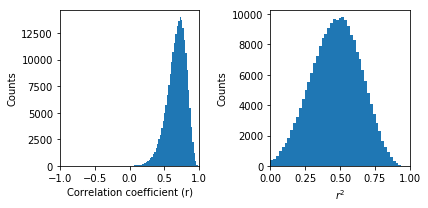

In [128]:
f, axes = plt.subplots(1, 2, figsize=(6, 3))
ax = axes[0]
ax.hist(ccs_bb_hg.ravel(), bins=np.linspace(-1, 1, 100))
ax.set_xlabel('Correlation coefficient (r)')
ax.set_ylabel('Counts')
ax.set_xlim(-1, 1)

ax = axes[1]
ax.hist(ccs_bb_hg.ravel()**2, bins=np.linspace(0, 1, 50))
ax.set_xlabel(r'$r^2$')
ax.set_ylabel('Counts')
ax.set_xlim(0, 1)

f.tight_layout()
plt.savefig('/home/jesse/Downloads/{}_hg_bb(hg)_corr.pdf'.format(subject))

In [ ]:
cv_channels = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                      '{}_hg_power_cutoff_bb2.npz'.format(subject)))['cv_channels']

ccs_diff = ccs_hg_beta_u-ccs_hg_beta
ccs_diff_condensed = np.empty(cv_channels.shape, dtype=np.object)
for ii in range(57):
    idxs = np.where(labels == ii)[0]
    for jj in range(cv_channels.shape[1]):
        ccs_diff_condensed[ii, jj] = ccs_diff[idxs][:, jj].tolist()

Ttest_indResult(statistic=56.29752377516102, pvalue=0.0)
RanksumsResult(statistic=60.42000594116616, pvalue=0.0)
MannwhitneyuResult(statistic=2470425749.0, pvalue=0.0)


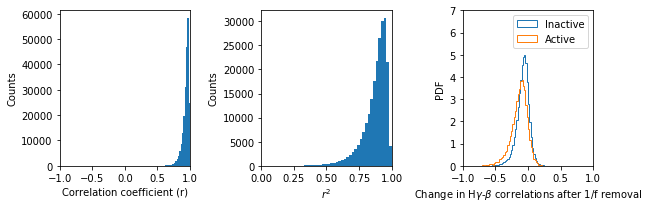

In [127]:
f, axes = plt.subplots(1, 3, figsize=(9, 3))
ax = axes[0]
ax.hist(ccs_beta_beta_u.ravel(), bins=np.linspace(-1, 1, 100))
ax.set_xlabel('Correlation coefficient (r)')
ax.set_ylabel('Counts')
ax.set_xlim(-1, 1)

ax = axes[1]
ax.hist(ccs_beta_beta_u.ravel()**2, bins=np.linspace(0, 1, 50))
ax.set_xlabel(r'$r^2$')
ax.set_ylabel('Counts')
ax.set_xlim(0, 1)

ax = axes[2]
bins = np.linspace(-1, 1, 101)
ya = np.concatenate(ccs_diff_condensed.ravel()[~cv_channels.ravel()])
ax.hist(ya, bins, density=True, histtype='step', label='Inactive')

yi = np.concatenate(ccs_diff_condensed.ravel()[cv_channels.ravel()])
ax.hist(yi, bins, density=True, histtype='step', label='Active')
ax.set_ylabel('PDF')
ax.set_xlabel(r'Change in H$\gamma$-$\beta$ correlations after 1/f removal')
ax.legend(loc='upper right')
ax.set_ylim(0, 7)
ax.set_xlim(-1, 1)
print(ttest_ind(ya, yi, equal_var=False))
print(ranksums(ya, yi))
print(mannwhitneyu(ya, yi, alternative='two-sided'))

f.tight_layout()
plt.savefig('/home/jesse/Downloads/{}_beta_beta_u_corr.pdf'.format(subject))

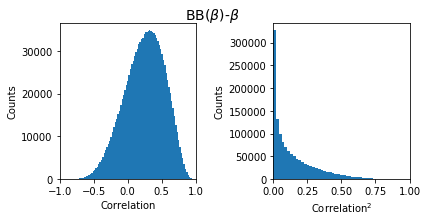

In [24]:
f, axes = plt.subplots(1, 2, figsize=(6, 3))
ax = axes[0]
ax.hist(ccs_bb_beta.ravel(), bins=np.linspace(-1, 1, 100))
ax.set_xlabel('Correlation')
ax.set_ylabel('Counts')
ax.set_xlim(-1, 1)

ax = axes[1]
ax.hist(ccs_bb_beta.ravel()**2, bins=np.linspace(0, 1, 50))
ax.set_xlabel(r'$R^2$')
ax.set_ylabel('Counts')
ax.set_xlim(0, 1)

f.tight_layout()
plt.savefig('/home/jesse/Downloads/{}_bb(b)_b_corr.pdf'.format(subject))

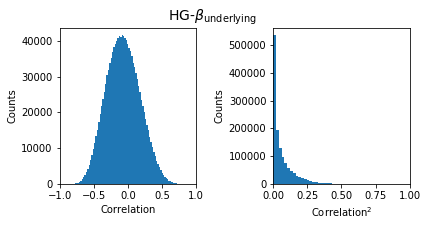

In [16]:
f, axes = plt.subplots(1, 2, figsize=(6, 3))
ax = axes[0]
ax.hist(ccs_hg_beta_u.ravel(), bins=np.linspace(-1, 1, 100))
ax.set_xlabel('Correlation')
ax.set_ylabel('Counts')
ax.set_xlim(-1, 1)

ax = axes[1]
ax.hist(ccs_hg_beta_u.ravel()**2, bins=np.linspace(0, 1, 50))
ax.set_xlabel(r'Correlation$^2$')
ax.set_ylabel('Counts')
ax.set_xlim(0, 1)

f.text(.5, .97, r'HG-$\beta_\mathrm{underlying}$', fontsize=14, ha='center')

f.tight_layout()
plt.savefig('/home/jesse/Downloads/{}_hg_beta_u_corr.pdf'.format(subject))

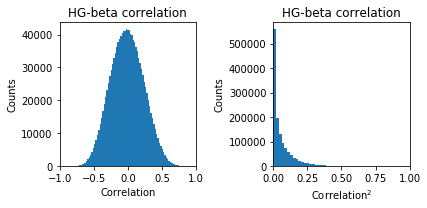

In [43]:
f, axes = plt.subplots(1, 2, figsize=(6, 3))
ax = axes[0]
ax.hist(ccs_hg_beta.ravel(), bins=np.linspace(-1, 1, 100))
ax.set_xlabel('Correlation')
ax.set_title('HG-beta correlation')
ax.set_ylabel('Counts')
ax.set_xlim(-1, 1)

ax = axes[1]
ax.hist(ccs_hg_beta.ravel()**2, bins=np.linspace(0, 1, 50))
ax.set_xlabel(r'Correlation$^2$')
ax.set_title('HG-beta correlation')
ax.set_ylabel('Counts')
ax.set_xlim(0, 1)
f.tight_layout()
plt.savefig('/home/jesse/Downloads/{}_hg_beta_corr.pdf'.format(subject))

Text(0,0.5,'(H$\\gamma$, $\\beta_{underlying}$) - (H$\\gamma$, $\\beta_{measured}$) change in correlation')

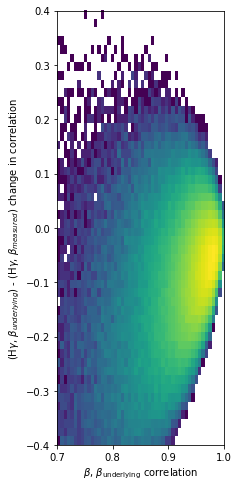

In [52]:
plt.figure(figsize=(3, 8))
plt.hist2d(ccs_beta_beta_u.ravel(), ccs_hg_beta_u.ravel()-ccs_hg_beta.ravel(),
          bins=[np.linspace(.7, 1, 51), np.linspace(-.4, .4, 51)], norm=colors.LogNorm())
plt.xlabel(r'$\beta$, $\beta_\mathrm{underlying}$ correlation')
plt.ylabel(r'(H$\gamma$, $\beta_{underlying}$) - (H$\gamma$, $\beta_{measured}$) change in correlation')

In [53]:
cv_channels = np.load(os.path.join(os.environ['HOME'], 'plots/xfreq/data',
                      '{}_hg_power_cutoff_bb2.npz'.format(subject)))['cv_channels']

In [59]:
cv_channels.shape

(57, 86)

In [50]:
from matplotlib import colors

In [98]:
(ccs_hg_beta_u-ccs_hg_beta).shape

(2572, 86)

In [99]:
ccs_diff = ccs_hg_beta_u-ccs_hg_beta
ccs_diff_condensed = np.empty(cv_channels.shape, dtype=np.object)
for ii in range(57):
    idxs = np.where(labels == ii)[0]
    for jj in range(cv_channels.shape[1]):
        ccs_diff_condensed[ii, jj] = ccs_diff[idxs][:, jj].tolist()

Text(0,0.5,'Correlation')

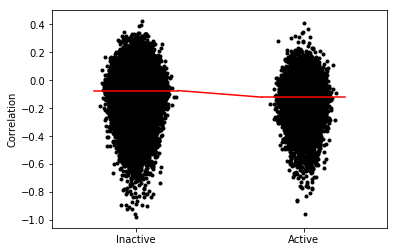

In [102]:
f, ax = plt.subplots(1)

yi = np.concatenate(ccs_diff_condensed.ravel()[~cv_channels.ravel()])
x = np.zeros_like(yi) + np.random.randn(yi.size) / 20.
ax.scatter(x, yi, marker='.', c='k')
ax.plot([-.25, .25], [np.median(yi), np.median(yi)], c='red')

ya = np.concatenate(ccs_diff_condensed.ravel()[cv_channels.ravel()])
x = np.ones_like(ya) + np.random.randn(ya.size) / 20.
ax.scatter(x, ya, marker='.', c='k')
ax.plot([1-.25, 1+.25], [np.median(ya), np.median(ya)], c='red')
ax.plot([.25, 1-.25], [np.median(yi), np.median(ya)], c='red')

ax.set_xlim(-.5, 1.5)

ax.set_xticks([0, 1])
ax.set_xticklabels(['Inactive', 'Active'])
ax.set_ylabel('Correlation')

Ttest_indResult(statistic=56.29752377516102, pvalue=0.0)
RanksumsResult(statistic=60.42000594116616, pvalue=0.0)
MannwhitneyuResult(statistic=2470425749.0, pvalue=0.0)


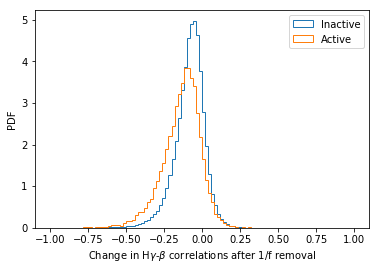

In [117]:
f, ax = plt.subplots(1)

bins = np.linspace(-1, 1, 101)
ya = np.concatenate(ccs_diff_condensed.ravel()[~cv_channels.ravel()])
ax.hist(ya, bins, density=True, histtype='step', label='Inactive')

yi = np.concatenate(ccs_diff_condensed.ravel()[cv_channels.ravel()])
ax.hist(yi, bins, density=True, histtype='step', label='Active')
ax.set_ylabel('PDF')
ax.set_xlabel(r'Change in H$\gamma$-$\beta$ correlations after 1/f removal')
ax.legend()
print(ttest_ind(ya, yi, equal_var=False))
print(ranksums(ya, yi))
print(mannwhitneyu(ya, yi, alternative='two-sided'))

In [69]:
cv_channels

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [26]:
ccs_hg_beta.ravel().shape

(221192,)

In [27]:
ccs_bb_hg.ravel().shape

(221192,)

# Spectra

In [4]:
for ii, s in enumerate(subjects):
    fname = os.path.join(folder, files[ii])
    X, baselines, good_examples, good_channels, tokens, block_labels, labels = load_data(fname)
    labels_set = sorted(set(labels))
    channels = X.shape[2]
    Xm = np.full((40, len(labels_set), channels), np.nan)
    for ii, cv in enumerate(labels_set):
        Xm[:, ii] = np.median(X[:, labels==cv].mean(axis=1), axis=-1)
    np.savez('{}_medians'.format(s), Xm=Xm)

2572 85
1570 77
5209 80
1422 96


(20, 40)
(20, 40)
(20, 40)
(20, 40)


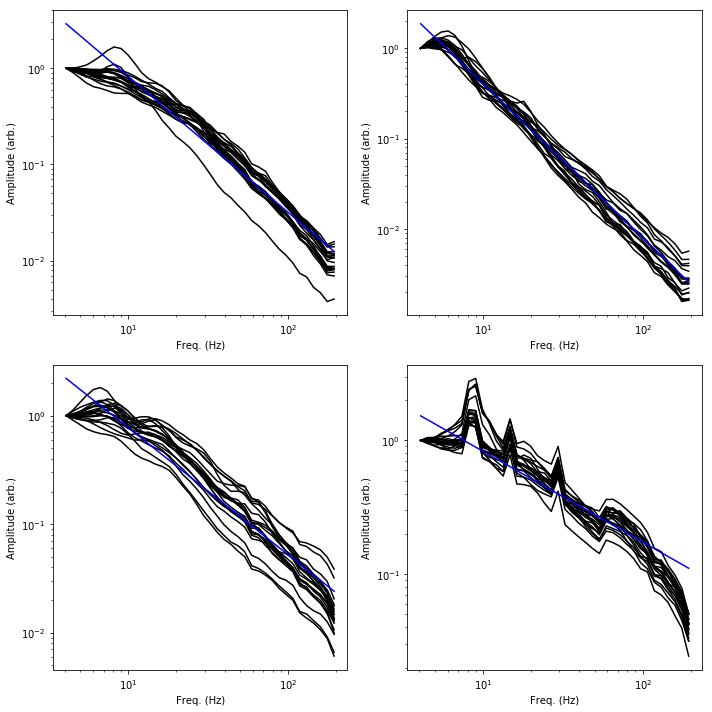

In [26]:
f, axes = plt.subplots(2, 2, figsize=(10, 10))
for ii, s in enumerate(subjects):
    d = np.load('{}_medians.npz'.format(s))
    Xm = d['Xm']
    ax = axes.ravel()[ii]
    y = Xm.reshape(40, -1).T
    y = y / y[:, [0]]
    x = bands.chang_lab['cfs']
    xt = np.tile(x[np.newaxis], (y.shape[0], 1))
    model = RANSACRegressor().fit(np.log(xt).ravel()[:, np.newaxis], np.log(y).ravel())
    yp = np.exp(model.estimator_.coef_ * np.log(x) + model.estimator_.intercept_)
    order = np.random.permutation(y.shape[0])[:20]
    y = y[order]
    print(y.shape)
    for yi in y:
        ax.plot(x, yi, c='black')
    ax.plot(x, yp, c='blue')
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_ylabel('Amplitude (arb.)')
    ax.set_xlabel('Freq. (Hz)')
f.tight_layout()